##### The complete example of training an instance of the discriminator model on real and randomly generated (fake) images is listed below.

In [1]:
# example of training the discriminator model on real and random mnist images
import numpy as np
import tensorflow
from numpy import expand_dims, ones, zeros, asarray
from numpy.random import randn
from numpy.random import rand
from numpy.random import randint
from tensorflow.keras.optimizers import Adam,RMSprop
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Conv1D, Flatten, Dropout, LeakyReLU, ZeroPadding1D, Cropping1D, MaxPooling1D, UpSampling1D, Flatten
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.layers import Reshape
from matplotlib import pyplot
import pickle
import winsound
from scipy.linalg import sqrtm
import tqdm

In [3]:
model = load_model('generator_model_20000.h5')
model.summary()

Model: "sequential_68"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_46 (Dense)             (None, 19200)             1939200   
_________________________________________________________________
leaky_re_lu_23 (LeakyReLU)   (None, 19200)             0         
_________________________________________________________________
reshape_23 (Reshape)         (None, 150, 128)          0         
_________________________________________________________________
conv1d_174 (Conv1D)          (None, 150, 128)          65664     
_________________________________________________________________
up_sampling1d_75 (UpSampling (None, 300, 128)          0         
_________________________________________________________________
conv1d_175 (Conv1D)          (None, 300, 128)          65664     
_________________________________________________________________
up_sampling1d_76 (UpSampling (None, 600, 128)        

In [ ]:
training_set = None

with open('dataset/normalized_normal.pickle', 'rb') as data:
    normalizedNormal = pickle.load(data)
with open('dataset/normalized_fault.pickle', 'rb') as data:
    normalizedFault = pickle.load(data)
training_set = np.concatenate((normalizedNormal,normalizedFault),axis=1)
training_set = training_set[0:100]
dimensionsCount = 6
sequenceLen = 400
trainDataSize = training_set.shape[0]
latent_dim = 100
#learningRate = 0.001 #opt = Adam(lr=0.0002, beta_1=0.5)
b1 = 0.5

In [3]:
# load and prepare mnist training images
def load_real_samples():
    return training_set

In [4]:
# select real samples
def generate_real_samples(dataset, n_samples):
    # choose random instances
    ix = randint(0, dataset.shape[0], n_samples)
    # retrieve selected images
    X = dataset[ix]
    # generate 'real' class labels (1)
    y = ones((n_samples, 1))
    return X, y

## GENERATOR PART

In [5]:
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
    # generate points in the latent space
    x_input = randn(latent_dim * n_samples)
    # reshape into a batch of inputs for the network
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

In [6]:
# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
    # generate points in latent space
    x_input = generate_latent_points(latent_dim, n_samples)
    # predict outputs
    X = g_model.predict(x_input)
    # create 'fake' class labels (0)
    #y = zeros((n_samples, 1))
    y = -ones((n_samples, 1))
    return X, y

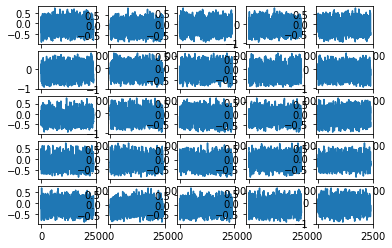

In [12]:
# define the discriminator model
model = define_generator(latent_dim)
# generate samples
n_samples = 25
X, _ = generate_fake_samples(model, latent_dim, n_samples)
# plot the generated samples
for i in range(n_samples):
    # define subplot
    pyplot.subplot(5, 5, 1 + i)
    pyplot.plot(X[i, :,:])
    
# show the figure
pyplot.show()

In [13]:
X.shape

(25, 2400, 1)

## GAN

In [14]:
# create and save a plot of generated images (reversed grayscale)
def save_plot(examples, epoch, n=10):
    # plot images
    for i in range(n * n):
        # define subplot
        pyplot.subplot(n, n, 1 + i)
        # turn off axis
        pyplot.axis('off')
        # plot raw pixel data
        pyplot.plot(examples[i, :, :])
    # save plot to file
    filename = 'generated_plot_e%03d.png' % (epoch+1)
    pyplot.savefig(filename)
    pyplot.close()
 
# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
    # prepare real samples
    #X_real, y_real = generate_real_samples(dataset, n_samples)
    # evaluate discriminator on real examples
    #_, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
        # prepare fake examples
    #x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    #_, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    #print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
    # save plot
    #save_plot(x_fake, epoch)
    # save the generator model tile file
    filename = 'generator_model_%03d.h5' % (epoch + 1)
    g_model.save(filename)


In [15]:
def calculate_fid(act1, act2):
	# calculate mean and covariance statistics
	mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=True)
	mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=True)
	# calculate sum squared difference between means
	ssdiff = np.sum((mu1 - mu2)**2.0)
	# calculate sqrt of product between cov
	covmean = sqrtm(sigma1.dot(sigma2))
	# check and correct imaginary numbers from sqrt
	if np.iscomplexobj(covmean):
		covmean = covmean.real
	# calculate score
	fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
	return fid


# create a line plot of loss for the gan and save to file
def plot_history(d1_hist, d2_hist, g_hist):
    # plot history
    pyplot.plot(d1_hist, label='crit_real')
    pyplot.plot(d2_hist, label='crit_fake')
    pyplot.plot(g_hist, label='gen')
    pyplot.legend()
    pyplot.savefig('plot_line_plot_loss.png')
    pyplot.close()
    #pyplot.show()


In [16]:
# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=500, n_batch=256, gTrainIteration = 1, dTrainIteration = 1, fidBasedSave = 0, verbose = 0):
    flattened_dataset = np.reshape(dataset, (trainDataSize,sequenceLen*dimensionsCount,1), order='C')
    dataSetSize = dataset.shape[0]
    bat_per_epo = int(dataSetSize / n_batch)
    half_batch = int(n_batch / 2)
    minFid = 999999
    bestGModel = None
    bestDModel = None
    # manually enumerate epochs
    disableTqdm = 0
    g_loss = 0
    lossPrintPrecision = 10
    dRealHist, dFakeHist, gHist = list(), list(), list()
    if verbose:
        disableTqdm = 1
    with tqdm.tqdm(total=n_epochs, disable=disableTqdm) as p_bar:
        for i in range(n_epochs):
            # enumerate batches over the training set
            for j in range(bat_per_epo):
                dRealTmp, dFakeTmp = list(), list()
                for k in range(dTrainIteration):
                    # get randomly selected 'real' samples
                    X_real, y_real = generate_real_samples(dataset, half_batch)
                    # generate 'fake' examples
                    X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
                    # create training set for the discriminator
                    flattened_X_real = np.reshape(X_real, (half_batch,sequenceLen*dimensionsCount,1), order='C')
                    #X, y = np.vstack((flattened_X_real, X_fake)), np.vstack((y_real, y_fake))
                    # update discriminator model weights
                    #d_loss, _ = d_model.train_on_batch(X, y)
                    #print(flattened_X_real.shape)
                    #print(y_real)
                    d_loss_real = d_model.train_on_batch(flattened_X_real, y_real)
                    dRealTmp.append(d_loss_real)
                    #print(X_fake)
                    #print(y_fake)
                    d_loss_fake  = d_model.train_on_batch(X_fake, y_fake)
                    dFakeTmp.append(d_loss_fake)
                    if verbose:
                        print('>%d, %d/%d, d_real=%.3f, d_fake=%.3f, g=%.3f, DDD' % (i+1, j+1, bat_per_epo, d_loss_real, d_loss_fake, g_loss))
                dRealHist.append(np.mean(d_loss_real))
                dFakeHist.append(np.mean(d_loss_fake))
                gHistTmp = list()
                for k in range(gTrainIteration):
                    # prepare points in latent space as input for the generator
                    X_gan = generate_latent_points(latent_dim, n_batch)
                    # create inverted labels for the fake samples
                    y_gan = np.ones((n_batch, 1))
                    # update the generator via the discriminator's error
                    g_loss = gan_model.train_on_batch(X_gan, y_gan)
                    gHistTmp.append(g_loss)
                    if verbose:
                        print('>%d, %d/%d, d_real=%.3f, d_fake=%.3f, g=%.3f, GGG' % (i+1, j+1, bat_per_epo, d_loss_real, d_loss_fake, g_loss))
                gHist.append(np.mean(gHistTmp))
            # ADDED BY MZ for FID calculations
            if fidBasedSave:
                X_real, y_real = generate_real_samples(dataset, n_batch)
                X_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_batch)
                fid = calculate_fid(X_fake.reshape((n_batch,sequenceLen*dimensionsCount)),X_real.reshape((n_batch,sequenceLen*dimensionsCount)))
                if fid < minFid:
                    minFid = fid
                    bestGModel = g_model
                    bestDModel = d_model
                if verbose:
                    print('>%d, %d/%d, d_real=%.3f, d_fake=%.3f, g=%.3f, fid=%.3f' % (i+1, j+1, bat_per_epo, d_loss_real, d_loss_fake, g_loss, fid))
            else:
                if verbose:
                    print('>%d, %d/%d, d_real=%.3f, d_fake=%.3f, g=%.3f' % (i+1, j+1, bat_per_epo, d_loss_real, d_loss_fake, g_loss))
                bestGModel = g_model
                bestDModel = d_model
            p_bar.update(1)
    summarize_performance(i, bestGModel, bestDModel, flattened_dataset, latent_dim)
    X_real, _ = generate_real_samples(dataset, dataSetSize)
    X_fake, _ = generate_fake_samples(bestGModel, latent_dim, dataSetSize)
    fid = calculate_fid(X_fake.reshape((dataSetSize,sequenceLen*dimensionsCount)),X_real.reshape((dataSetSize,sequenceLen*dimensionsCount)))
    if fidBasedSave:
        print("min fid:", minFid)
    else:
        print("last fid:", fid)
    plot_history(dRealHist, dFakeHist, gHist)

In [6]:
from numpy.random import seed
seed(1)
from tensorflow import random
random.set_seed(1)

learningRate = 0.001

# Generator
gHiddenLayers = 3
gFilterSize = 4
gFilterCount = 128
gLearningRate = learningRate
gTrainIterationParam = 20

# Discriminator
dHiddenLayers = 3
dFilterSize = 4
dFilterCount = 128
dLearningRate = learningRate
dDropOut = 0
dTrainIterationParam = 1


trainingEpochs = 20000
const = ClipConstraint(0.01)
#init = RandomNormal(stddev=0.02)
init = RandomNormal(stddev=0.2)


#latent_dim = (sequenceLen*dimensionsCount) // 2**(gHiddenLayers+1) # to remove dense layer at the beginning of generator
latent_dim = 100

NameError: name 'ClipConstraint' is not defined

In [126]:
# OLD generator
# define the standalone generator model
# def define_generator(latent_dim):
#     model = Sequential()
#     numOfConvLayers = gHiddenLayers
#     numOfFiltersInFirstLayer = gFilterCount
#     filterSize = gFilterSize
#     poolingLayerSize = 2
#     featureVectorSize = sequenceLen*dimensionsCount // 2 ** numOfConvLayers # 2400(total number of features / (poolin layers) ^ 2)
#     n_nodes = numOfFiltersInFirstLayer * featureVectorSize
#     model.add(Dense(n_nodes, input_dim=latent_dim))
#     model.add(LeakyReLU(alpha=0.2))
#     model.add(Reshape((featureVectorSize, numOfFiltersInFirstLayer)))
#     for i in range(numOfConvLayers):
#         model.add(Conv1D(numOfFiltersInFirstLayer // (2**i), filterSize, activation='relu', padding = 'same'))
#         model.add(UpSampling1D(poolingLayerSize))
#     model.add(Conv1D(1, filterSize, activation='linear', padding = 'same'))
#     return model
#
# # define the standalone discriminator model
# def define_discriminator(FiltersCountInFirstLayer = dFilterCount, printSummary = 1, vrbs = 1, return_best = 0, filterSize = dFilterSize, learningRate = dLearningRate, hiddenLayers = dHiddenLayers):
#     poolingSize = 2
#     paddingSize = (filterSize // 2)
#     model = Sequential()
#     model.add(ZeroPadding1D(paddingSize,input_shape=(sequenceLen * dimensionsCount,1)))
#     model.add(Conv1D(int(FiltersCountInFirstLayer), filterSize, activation='relu', padding = 'same'))
#
#     for i in range(hiddenLayers):
#         model.add(MaxPooling1D(poolingSize, padding='same'))
#         model.add(Conv1D(int(FiltersCountInFirstLayer*2**i), filterSize, activation='relu', padding = 'same'))
#     model.add(Dropout(dDropOut))
#     model.add(Flatten())
#     model.add(Dense(1, activation='sigmoid'))
#     opt = Adam(lr=learningRate, beta_1 = b1)
#     model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
#     return model
#
# # define the combined generator and discriminator model, for updating the generator
# def define_gan(g_model, d_model):
#     # make weights in the discriminator not trainable
#     d_model.trainable = False
#     # connect them
#     model = Sequential()
#     # add generator
#     model.add(g_model)
#     # add the discriminator
#     model.add(d_model)
#     # compile model
#     opt = Adam(lr=gLearningRate, beta_1 = b1)
#     model.compile(loss='binary_crossentropy', optimizer=opt)
#     return model

In [127]:
from keras import backend
from tensorflow.keras.constraints import Constraint
from tensorflow import print as tfprint
from tensorflow.keras.initializers import RandomNormal

def wasserstein_loss(y_true, y_pred):
    #tfprint(y_true * y_pred)
    return backend.mean(y_true * y_pred)


# clip model weights to a given hypercube
class ClipConstraint(Constraint):
	# set clip value when initialized
	def __init__(self, clip_value):
		self.clip_value = clip_value

	# clip model weights to hypercube
	def __call__(self, weights):
		return backend.clip(weights, -self.clip_value, self.clip_value)

	# get the config
	def get_config(self):
		return {'clip_value': self.clip_value}

# define the standalone generator model
def define_generator(latent_dim):
    model = Sequential()
    numOfConvLayers = gHiddenLayers
    numOfFiltersInFirstLayer = gFilterCount
    filterSize = gFilterSize
    poolingLayerSize = 2
    featureVectorSize = sequenceLen*dimensionsCount // 2 ** (numOfConvLayers+1) # 2400(total number of features / (poolin layers) ^ 2)
    n_nodes = numOfFiltersInFirstLayer * featureVectorSize

    ### OLD
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((featureVectorSize, numOfFiltersInFirstLayer)))


    #model.add(ZeroPadding1D(paddingSize,input_shape=latent_dim))
    #model.add(Conv1D(numOfFiltersInFirstLayer, filterSize, activation='relu', padding = 'same', input_shape=(latent_dim,1), kernel_initializer=init))
    model.add(Conv1D(numOfFiltersInFirstLayer, filterSize, activation='relu', padding = 'same', kernel_initializer=init))
    #model.add(Conv1D(numOfFiltersInFirstLayer, filterSize, activation='relu', padding = 'same'))
    model.add(UpSampling1D(poolingLayerSize))
    for i in range(numOfConvLayers):
        model.add(Conv1D(numOfFiltersInFirstLayer // (2**i), filterSize, activation='relu', padding = 'same', kernel_initializer=init))
        model.add(UpSampling1D(poolingLayerSize))
    model.add(Conv1D(1, filterSize, activation='tanh', padding = 'same'))
    return model

# define the standalone discriminator model
def define_discriminator(FiltersCountInFirstLayer = dFilterCount, printSummary = 1, vrbs = 1, return_best = 0, filterSize = dFilterSize, learningRate = dLearningRate, hiddenLayers = dHiddenLayers):
    poolingSize = 2
    paddingSize = (filterSize // 2)
    model = Sequential()
    model.add(ZeroPadding1D(paddingSize,input_shape=(sequenceLen * dimensionsCount,1)))
    model.add(Conv1D(int(FiltersCountInFirstLayer), filterSize, activation='relu', padding = 'same', kernel_constraint=const, kernel_initializer=init))
    model.add(Dropout(dDropOut))
    for i in range(hiddenLayers):
        model.add(MaxPooling1D(poolingSize, padding='same'))
        model.add(Conv1D(int(FiltersCountInFirstLayer*2**i), filterSize, activation='relu', padding = 'same', kernel_constraint=const, kernel_initializer=init))
        model.add(Dropout(dDropOut))
    #model.add(Dropout(dDropOut))
    model.add(Flatten())
    #model.add(Dense(1, activation='sigmoid'))
    model.add(Dense(1, activation='sigmoid'))
    #opt = Adam(lr=learningRate, beta_1 = b1)
    opt = RMSprop(lr=0.00005)
    #loss=BinaryCrossentropy(from_logits=True)
    loss = wasserstein_loss
    model.compile(loss=loss, optimizer=opt)
    #model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
    # make weights in the discriminator not trainable
    d_model.trainable = False
    # connect them
    model = Sequential()
    # add generator
    model.add(g_model)
    # add the discriminator
    model.add(d_model)
    # compile model
    #opt = Adam(lr=gLearningRate, beta_1 = b1)
    opt = RMSprop(lr=0.00005)
    #loss=BinaryCrossentropy(from_logits=True)
    loss = wasserstein_loss
    model.compile(loss=wasserstein_loss, optimizer=opt)
    return model

In [128]:
# epochs from 500 to 1000
numEpochs = trainingEpochs
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples()
# train model
train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=numEpochs, n_batch=100, gTrainIteration=gTrainIterationParam, dTrainIteration=dTrainIterationParam , fidBasedSave=0, verbose=1)

#Finishing sound
duration = 100  # milliseconds
freq = 140  # Hz
winsound.MessageBeep(winsound.MB_ICONHAND)
    
#pyplot.show()

>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.000, DDD
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-0.499, g=0.500, GGG
>1, 1/1, d_real=0.367, d_fake=-

### Dataset generation

In [8]:
numEpochs = 20000

In [9]:
model = load_model('generator_model_' + str(numEpochs).zfill(3) + '.h5')
#optimizer = Adam(lr=0.001, clipnorm=0.001)
#model.compile(loss='mean_squared_error', optimizer=optimizer)
numOfData = 1000
dataList = list()
#for i in range(numOfData):
#    vector = asarray([rand(latent_dim)])
#    X = model.predict(vector)
#    dataList.append(X.reshape(400,6))
vector = rand(numOfData,latent_dim)
dataArray = model.predict(vector)
dataArray = dataArray.reshape((numOfData,sequenceLen, dimensionsCount))
dataArray.shape

(1000, 400, 6)

In [15]:
training_set.shape
dataArrayComp = np.concatenate((dataArray,training_set))

In [19]:
with open('../Data_Set/dataset_generated_gan_complete.pickle', 'wb') as f:
    pickle.dump(dataArrayComp[:,:], f)

In [11]:
with open('../Data_Set/dataset_generated_gan.pickle', 'wb') as f:
    pickle.dump(dataArray[:,176:224], f)

# Plot example

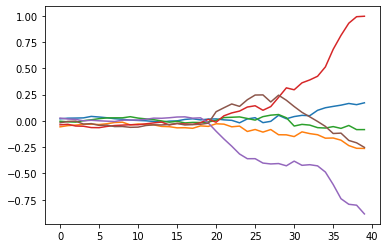

In [130]:
# Learning rate from 0.0009 to 0.001 and beta to default with 500 epochs

# load model
#optimizer = Adam(lr=0.001, clipnorm=0.001)
#model.compile(loss='mean_squared_error', optimizer=optimizer)
# all 0s
#vector = asarray([[0 for _ in range(latent_dim)]])
# rand vector
vector = asarray([rand(latent_dim)])
# generate image
X = model.predict(vector)
pyplot.plot(X.reshape((400,6))[180:220])
#model.summary()

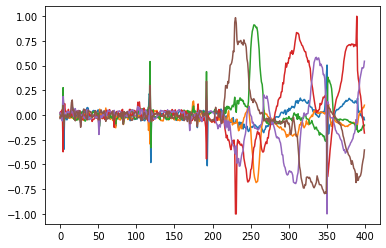

In [18]:
vector = asarray([rand(latent_dim)])
X = model.predict(vector)
pyplot.plot(X.reshape((400,6))[:])